### introduction

running collab with drive 

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

In [ ]:
imgloader = "/content/gdrive/MyDrive/Covid19-dataset-2"

In [ ]:
train = imgloader + "/train"
test = imgloader + "/test"

printing an image

In [ ]:
print(train)
print(test)

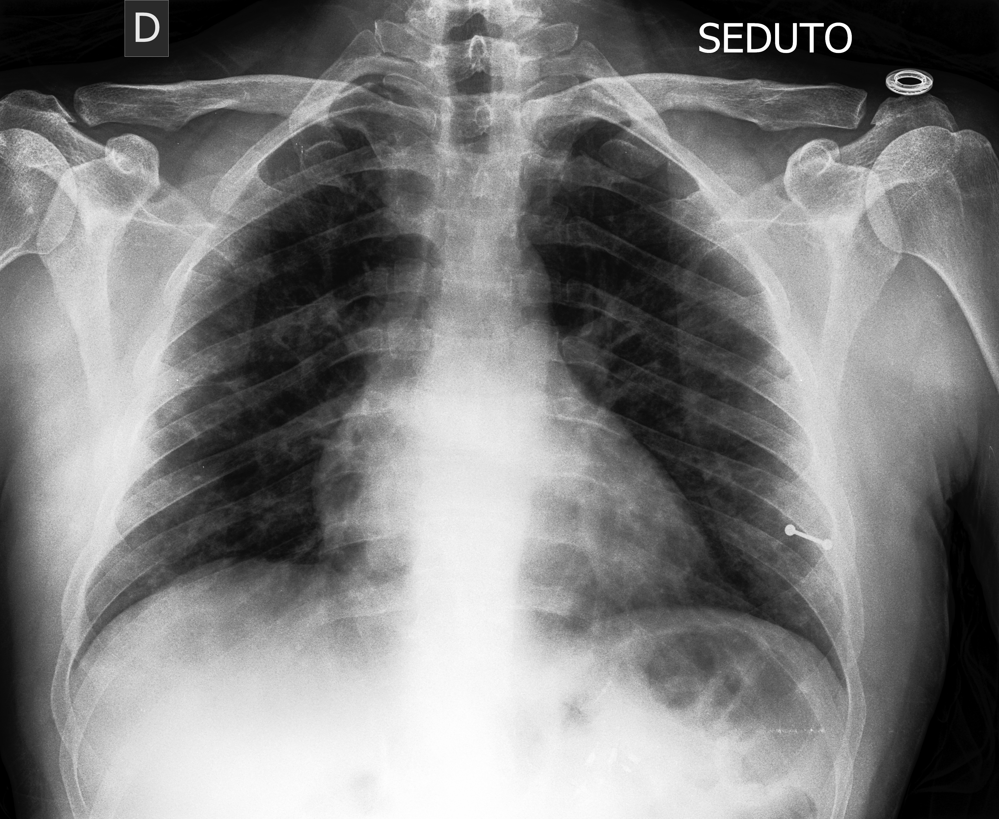

In [ ]:
import cv2 
from google.colab.patches import cv2_imshow
img = cv2.imread(train + "/Covid/01.jpeg")
cv2_imshow(img)

###statistical features

In [ ]:
%matplotlib inline
from PIL import Image, ImageOps, ImageFilter, ImageEnhance
import tqdm
import pickle
import numpy as np
import matplotlib.pyplot as plt
#from torchvision import datasets
from skimage.filters import gabor
from skimage.feature import local_binary_pattern, greycomatrix, greycoprops
import os
import glob
#import cv2
import csv
import re
import cv2


### Number of files in the image dataset 

In [ ]:
count_train = 0 
count_test = 0 

count_normal = 0 
count_viral = 0 
count_covid = 0 

train_normal = train + "/Normal"
train_viral = train + "/Viral"
train_covid = train + "/Covid"

test_normal = test + "/Normal"
test_viral = test + "/Viral"
test_covid = test + "/Covid"


for path, subdirs, files in os.walk(train_normal):
  for name in files: 
    count_normal = count_normal + 1


print(count_normal)


70


In [ ]:
def count_files(address):
  count = 0 
  for path, subdirs, files in os.walk(address):
    for name in files:
      count = count + 1

  return count

In [ ]:
count_train = count_files(train_normal) +count_files(train_covid) + count_files(train_viral)
count_test = count_files(test_normal) + count_files(test_viral) + count_files(test_covid)

print(count_train)
print(count_test)


count_normal = count_files(train_normal) + count_files(test_normal)
count_viral = count_files(train_viral) + count_files(test_viral)
count_covid = count_files(train_covid) + count_files(test_covid)

print(count_normal)
print(count_viral)
print(count_covid)

251
66
90
90
137


### " similar to the load the image dataset " block

In [ ]:
from skimage import exposure
from skimage import util

In [ ]:
classes = ['Normal', 'Viral', 'Covid']
dataset = [] 
skip = 0 
count = 0 
for label in classes: 
  path = os.path.join(train, label)
  class_label = classes.index(label)
  for file in os.listdir(path):
    filename = os.path.basename(file)
    filenames = re.split('\.',filename)
    img = cv2.imread(os.path.join(path, file),0)
    print(img)
    img = cv2.resize(img, (150, 150), interpolation = cv2.INTER_AREA)
    img = cv2.bilateralFilter(img,10,75,75)
    img = exposure.equalize_hist(img)
    img = util.img_as_ubyte(img)
    brisk = cv2.BRISK_create()
    orb = cv2.ORB_create()
    akaze = cv2.AKAZE_create()
    kaze = cv2.KAZE_create()
    kp, des = orb.detectAndCompute(img,None)
    kp1, des1 = brisk.detectAndCompute(img, None)
    kp2, des2 = akaze.detectAndCompute(img, None)
    kp3, des3 = kaze.detectAndCompute(img, None)
    dataset.append([img, len(kp),len(kp1), len(kp2), filenames[0], class_label, len(kp3)])
    count = count + 1
    skip = skip + 1
print(len(dataset))

In [ ]:
print(dataset[-9][2])  

In [ ]:
plt.figure(figsize = (5,5))
plt.imshow(dataset[0][0], cmap='gray')

In [ ]:
plt.figure(figsize = (5,5))
plt.imshow(dataset[2][0], cmap='gray')

### preprocess the dataset

In [ ]:
from skimage import exposure

def crop_img(img, scale=1.0):
    center_x, center_y = img.shape[1] / 2, img.shape[0] / 2
    width_scaled, height_scaled = img.shape[1] * scale, img.shape[0] * scale
    left_x, right_x = center_x - width_scaled / 2, center_x + width_scaled / 2
    top_y, bottom_y = center_y - height_scaled / 2, center_y + height_scaled / 2
    img_cropped = img[int(top_y):int(bottom_y), int(left_x):int(right_x)]
    return img_cropped
def preprocess_data():
    preproData = []
    for img in train: 
        try:
            imgObj1 = img[0]
            preproData.append([imgObj1, img[1], img[2],img[3],img[4],img[5],img[6]])
        except Exception as e:
            print(e)
    return (preproData)

### Extract features 

In [ ]:
from skimage import util
import cv2
fields = ['IMG_NAME', 'LBP_ENERGY', 'LBP_ENTROPY', 'CONTRAST', 'DISSIMILARITY', 'HOMOGENEITY', 'ENERGY', 'CORRELATION', 'GBR_ENERGY', 'GBR_ENTROPY', 'ORB','BRISK','AKAZE','KAZE','DETECT'] 

In [ ]:
df = []
i = 0
for img in dataset:
  i = i + 1
  features = []
  img_arr = img[0]
  img_arr = util.img_as_ubyte(img_arr)
  print(img_arr)
  feat_lbp = local_binary_pattern(img_arr,8,1,'uniform') 
  feat_lbp = np.uint8((feat_lbp/feat_lbp.max())*255)
  lbp_hist,_ = np.histogram(feat_lbp,8)
  lbp_hist = np.array(lbp_hist,dtype=float)
  lbp_prob = np.divide(lbp_hist,np.sum(lbp_hist))
  lbp_energy = np.sum(lbp_prob**2)
  lbp_entropy = -np.sum(np.multiply(lbp_prob,np.log2(lbp_prob)))
  distance = [1, 2, 3, 4]
  angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]
  gCoMat = greycomatrix(np.array(img_arr), distances = distance, angles = angles, symmetric = True, normed = True)
  contrast = greycoprops(gCoMat, prop='contrast')
  dissimilarity = greycoprops(gCoMat, prop='dissimilarity')
  homogeneity = greycoprops(gCoMat, prop='homogeneity')
  energy = greycoprops(gCoMat, prop='energy')
  correlation = greycoprops(gCoMat, prop='correlation')
  moment = cv2.moments(np.array(img_arr))
  hu = cv2.HuMoments(moment)
  gaborFilt_real,gaborFilt_imag = gabor(img_arr,frequency=0.6)
  gaborFilt = (gaborFilt_real**2+gaborFilt_imag**2)//2
  gabor_hist,_ = np.histogram(gaborFilt,8)
  gabor_hist = np.array(gabor_hist,dtype=float)
  gabor_prob = np.divide(gabor_hist,np.sum(gabor_hist))
  gabor_energy = np.sum(gabor_prob**2)
  gabor_entropy = -np.sum(np.multiply(gabor_prob,np.log2(gabor_prob)))
  features.append(img[4])
  features.append("{:.5f}".format(lbp_energy))
  features.append("{:.5f}".format(lbp_entropy))
  features.append("{:.5f}".format(contrast[0][0]))
  features.append("{:.5f}".format(dissimilarity[0][0]))
  features.append("{:.5f}".format(homogeneity[0][0]))
  features.append("{:.5f}".format(energy[0][0]))
  features.append("{:.5f}".format(correlation[0][0]))
  features.append("{:.5f}".format(gabor_energy))
  features.append("{:.5f}".format(gabor_entropy))
  features.append(img[1])
  features.append(img[2])
  features.append(img[3])
  features.append(img[6])
  features.append(img[5])
  df.append(features)
                     

### Inspect the features 

In [ ]:
print(df)

In [ ]:
import numpy as np 
import pandas as pd 
arr = np.array(df)
df = pd.DataFrame(arr, columns = ['IMG_NAME', 'LBP_ENERGY', 'LBP_ENTROPY', 'CONTRAST', 'DISSIMILARITY', 'HOMOGENEITY', 'ENERGY', 'CORRELATION', 'GBR_ENERGY', 'GBR_ENTROPY', 'ORB','BRISK','AKAZE','KAZE','DETECT'])

### Decision table create

In [ ]:
subset1 = df.filter(['IMG_NAME','ORB','BRISK','KAZE','AKAZE','CONTRAST', 'DISSIMILARITY', 'LBP_ENTROPY', 'HOMOGENEITY', 'LBP_ENERGY','GBR_ENTROPY','GBR_ENERGY','ENERGY','hu','DETECT'], axis=1)
print(len(subset1))
#subset1 = subset1[~subset1['IMG_NAME'].str.contains('(?:_B)$')]
subset1 = subset1[:11520]
#print(len(subset1))
print(len(subset1))

In [ ]:
print(subset1)

In [ ]:
print(subset1[0:6])

In [ ]:
subset1 = subset1[:len(subset1) - 1]

In [ ]:
ln = 5
subset_train = subset1.sort_values(by = ['ORB'])
subset_train['ORB_L1'] = 0
print(subset_train)
print(len(subset_train))
subset1_list = np.vsplit(subset_train, ln)
print(len(subset1_list))
subset_train['ORB_L1'] = 0
k = 1
for row in range(len(subset_train)):
    i = 1
    for df1 in subset1_list:
        df1['ORB_L1'] = i
        min1 = df1['ORB'].min()
        max1 = df1['ORB'].max()
        if k == 1:
            print("ORB", df1['ORB'].min(), df1['ORB'].max())
        #print("ORB", df1['ORB'].min(), df1['ORB'].max())
        ##print(df1.head())
        if (subset_train.loc[row, 'ORB'] >= min1) & (subset_train.loc[row, 'ORB'] < max1) :
            subset_train.loc[row, 'ORB_L1'] = i
        if (i==len(subset1_list)) &  (subset_train.loc[row, 'ORB'] >= min1):
            subset_train.loc[row, 'ORB_L1'] = i
        i += 1
    k = 2
                

        IMG_NAME ORB BRISK KAZE AKAZE   CONTRAST DISSIMILARITY LBP_ENTROPY  \
249  COVID-00020   0     0   25     0   53.11517       3.84492     2.03813   
248  COVID-00023   0     0   48     7   43.36188       4.45736     2.22591   
118          078   0     0   26     1   81.09593       4.33020     2.03540   
117          056   0     1   34     2   75.77105       4.32139     2.07279   
114          096   0     0   13     0   39.32528       4.12063     1.87641   
..           ...  ..   ...  ...   ...        ...           ...         ...   
77            03   9     1   65     9   67.24975       4.76519     1.95172   
195          056   9     3   45     2   50.64072       4.13298     2.17137   
73           048   9     1   59     2  109.76564       5.34792     1.92070   
46            07   9     8   88     8   92.15405       5.55244     2.00136   
197          090   9     3   57     8   77.72568       5.47584     1.91367   

    HOMOGENEITY LBP_ENERGY GBR_ENTROPY GBR_ENERGY   ENERGY DETE

In [ ]:
print(subset_train)

        IMG_NAME ORB BRISK KAZE AKAZE   CONTRAST DISSIMILARITY LBP_ENTROPY  \
249  COVID-00020   0     0   25     0   53.11517       3.84492     2.03813   
248  COVID-00023   0     0   48     7   43.36188       4.45736     2.22591   
118          078   0     0   26     1   81.09593       4.33020     2.03540   
117          056   0     1   34     2   75.77105       4.32139     2.07279   
114          096   0     0   13     0   39.32528       4.12063     1.87641   
..           ...  ..   ...  ...   ...        ...           ...         ...   
77            03   9     1   65     9   67.24975       4.76519     1.95172   
195          056   9     3   45     2   50.64072       4.13298     2.17137   
73           048   9     1   59     2  109.76564       5.34792     1.92070   
46            07   9     8   88     8   92.15405       5.55244     2.00136   
197          090   9     3   57     8   77.72568       5.47584     1.91367   

    HOMOGENEITY LBP_ENERGY GBR_ENTROPY GBR_ENERGY   ENERGY DETE

In [ ]:
print(subset_train[0:5])

        IMG_NAME ORB BRISK KAZE AKAZE  CONTRAST DISSIMILARITY LBP_ENTROPY  \
249  COVID-00020   0     0   25     0  53.11517       3.84492     2.03813   
248  COVID-00023   0     0   48     7  43.36188       4.45736     2.22591   
118          078   0     0   26     1  81.09593       4.33020     2.03540   
117          056   0     1   34     2  75.77105       4.32139     2.07279   
114          096   0     0   13     0  39.32528       4.12063     1.87641   

    HOMOGENEITY LBP_ENERGY GBR_ENTROPY GBR_ENERGY   ENERGY DETECT  ORB_L1  
249     0.27135    0.30570     2.61640    0.21472  0.04947      2       1  
248     0.35143    0.25893     2.57145    0.22730  0.05927      2       1  
118     0.28976    0.30845     2.60957    0.21716  0.04663      1       1  
117     0.29880    0.29868     2.62418    0.21278  0.09545      1       1  
114     0.26710    0.35581     2.61394    0.21608  0.02256      1       1  


In [ ]:
subset_train = subset_train.sort_values(by = ['AKAZE'])
subset_train['AKAZE_L1'] = 0
subset1_list = np.vsplit(subset_train, ln)
k = 1
subset_train['AKAZE_L1'] = 0
for row in range(len(subset_train)):
    i = 1
    for df1 in subset1_list:
        df1['AKAZE_L1'] = i
        min1 = df1['AKAZE'].min()
        max1 = df1['AKAZE'].max()
        if k == 1:
            print("AKAZE", df1['AKAZE'].min(), df1['AKAZE'].max())
        #print("AKAZE", df1['AKAZE'].min(), df1['AKAZE'].max() )
        #print(df1.head())
        if (subset_train.loc[row, 'AKAZE'] >= min1) & (subset_train.loc[row, 'AKAZE'] < max1) :
            subset_train.loc[row, 'AKAZE_L1'] = i
        if (i==len(subset1_list)) &  (subset_train.loc[row, 'AKAZE'] >= min1):
            subset_train.loc[row, 'AKAZE_L1'] = i
        i += 1
    k=2


subset_train = subset_train.sort_values(by = ['BRISK'])
subset_train['BRISK_L1'] = 0
subset1_list = np.vsplit(subset_train, ln)

subset_train['BRISK_L1'] = 0
k = 1
for row in range(len(subset_train)):
    i = 1
    for df1 in subset1_list:
        df1['BRISK_L1'] = i
        min1 = df1['BRISK'].min()
        max1 = df1['BRISK'].max()
        #print("BRISK", df1['BRISK'].min(), df1['BRISK'].max() )
        #print(df1.head())
        if (subset_train.loc[row, 'BRISK'] >= min1) & (subset_train.loc[row, 'BRISK'] < max1) :
            subset_train.loc[row, 'BRISK_L1'] = i
        i += 1

                    
subset_train = subset_train.sort_values(by = ['KAZE'])
subset_train['KAZE_L1'] = 0
subset1_list = np.vsplit(subset_train, ln)

subset_train['KAZE_L1'] = 0
k = 1
for row in range(len(subset_train)):
    i = 1
    for df1 in subset1_list:
        df1['KAZE_L1'] = i
        min1 = df1['KAZE'].min()
        max1 = df1['KAZE'].max()
        if k == 1:
            print("KAZE", df1['KAZE'].min(), df1['KAZE'].max())
        #print("KAZE", df1['KAZE'].min(), df1['KAZE'].max() )
        #print(df1.head())
        if (subset_train.loc[row, 'KAZE'] >= min1) & (subset_train.loc[row, 'KAZE'] < max1) :
            subset_train.loc[row, 'KAZE_L1'] = i
        if (i==len(subset1_list)) &  (subset_train.loc[row, 'KAZE'] >= min1):
            subset_train.loc[row, 'KAZE_L1'] = i
        i += 1
    k = 2

subset_train = subset_train.sort_values(by = ['CONTRAST'])
subset_train['CONTRAST_L1'] = 0
subset1_list = np.vsplit(subset_train, ln)

subset_train['CONTRAST_L1'] = 0
for row in range(len(subset_train)):
    i = 1
    for df1 in subset1_list:
        df1['CONTRAST_L1'] = i
        min1 = df1['CONTRAST'].min()
        max1 = df1['CONTRAST'].max()
        #print("KAZE", df1['KAZE'].min(), df1['KAZE'].max() )
        #print(df1.head())
        if (subset_train.loc[row, 'CONTRAST'] >= min1) & (subset_train.loc[row, 'CONTRAST'] < max1) :
            subset_train.loc[row, 'CONTRAST_L1'] = i
        i += 1
        
        
        
subset_train = subset_train.sort_values(by = ['ENERGY'])
subset_train['ENERGY_L1'] = 0
subset1_list = np.vsplit(subset_train, ln)

subset_train['ENERGY_L1'] = 0
for row in range(len(subset_train)):
    i = 1
    for df1 in subset1_list:
        df1['ENERGY_L1'] = i
        min1 = df1['ENERGY'].min()
        max1 = df1['ENERGY'].max()
        #print("KAZE", df1['KAZE'].min(), df1['KAZE'].max() )
        #print(df1.head())
        if (subset_train.loc[row, 'ENERGY'] >= min1) & (subset_train.loc[row, 'ENERGY'] < max1) :
            subset_train.loc[row, 'ENERGY_L1'] = i
        i += 1



AKAZE 0 11
AKAZE 11 2
AKAZE 2 4
AKAZE 4 6
AKAZE 6 9
KAZE 10 25
KAZE 25 43
KAZE 43 58
KAZE 58 73
KAZE 73 97


### Print intervals

In [ ]:
pip install chart_studio 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 64 kB 2.2 MB/s 
  Created wheel for retrying: filename=retrying-1.3.3-py3-none-any.whl size=11447 sha256=213bca51c635fdeecfb1e15c540d3dbf2f6abfce12f859034e28ec02d8251962
  Stored in directory: /root/.cache/pip/wheels/f9/8d/8d/f6af3f7f9eea3553bc2fe6d53e4b287dad18b06a861ac56ddf
Successfully built retrying


In [ ]:
#Load module
import pandas as pd
#Load required modules
import plotly.graph_objs as go
import plotly
from plotly import tools
from sklearn.preprocessing import StandardScaler


import chart_studio
import chart_studio.plotly as py
chart_studio.tools.set_credentials_file(username='ssz389', api_key='YHKZl2yR1HkdFcThXArJ')

In [ ]:
trace0 = go.Box(
    y=subset1.loc[subset1['DETECT'] == 1]['CONTRAST'],
    name = 'PNU infected',
    marker = dict(
        color = 'rgb(214, 12, 140)',
    )
)
trace1 = go.Box(
    y=subset1.loc[subset1['DETECT'] == 0]['CONTRAST'],
    name = 'Normal',
    marker = dict(
        color = 'rgb(0, 128, 128)',
    )
)
data = [trace0, trace1]
layout = go.Layout(
    title = "Boxplot of X-ray images by CONTRAST"
)

fig = go.Figure(data=data,layout=layout)

py.iplot(fig)

In [ ]:
#subset1 = subset1.drop(['DISSIMILARITY','HOMOGENEITY', 'LBP_ENTROPY','LBP_ENERGY','ENERGY','CORRELATION','GBR_ENERGY','GBR_ENERGY'],axis=1)
#subset_train.to_csv (r'export_dataframe_afterdrop.csv', index = False, header=True)
sub_train_fin = subset_train.filter(['IMG_NAME','ORB','BRISK','AKAZE','KAZE','CONTRAST','ENERGY','ORB_L1','BRISK_L1','AKAZE_L1', 'KAZE_L1', 'CONTRAST_L1', 'ENERGY_L1', 'DETECT'], axis=1)
sub_train_fin.to_csv (r"final_train.csv", index = False, header=True) 

In [ ]:
subset1 = pd.read_csv (r'final_train.csv')
print(len(subset1))
subset1.head()

250


,IMG_NAME,ORB,BRISK,AKAZE,KAZE,CONTRAST,ENERGY,ORB_L1,BRISK_L1,AKAZE_L1,KAZE_L1,CONTRAST_L1,ENERGY_L1,DETECT
0,08,22,5,19,89,80.84264,0.01803,3,5,2,5,4,1,0
1,064,12,6,7,73,148.04174,0.01836,2,5,5,5,1,1,0
2,087,42,17,23,110,105.56734,0.01874,5,3,3,1,1,1,0
3,084,21,11,13,94,88.63843,0.01878,3,3,2,5,5,1,0
4,024,32,10,23,129,107.30541,0.01890,4,3,3,1,1,1,0


/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:337: UserWarning:

The `size` parameter has been renamed to `height`; please update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (

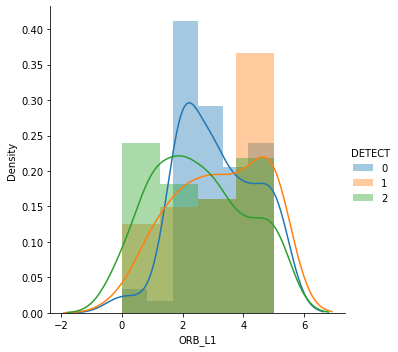

In [ ]:
import seaborn as sns, numpy as np
sns.FacetGrid(subset1,hue='DETECT',size=5).map(sns.distplot,'ORB_L1').add_legend()

/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:337: UserWarning:

The `size` parameter has been renamed to `height`; please update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (

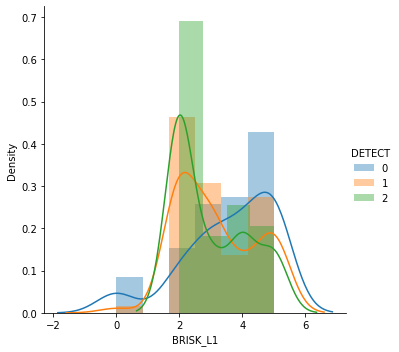

In [ ]:
import seaborn as sns, numpy as np
sns.FacetGrid(subset1,hue='DETECT',size=5).map(sns.distplot,'BRISK_L1').add_legend()

/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:337: UserWarning:

The `size` parameter has been renamed to `height`; please update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (

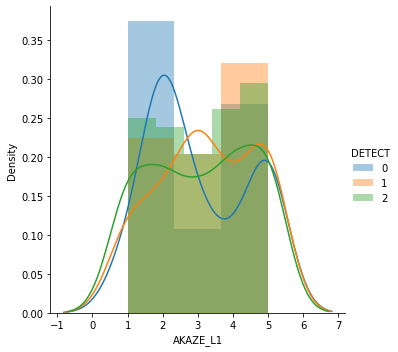

In [ ]:
import seaborn as sns, numpy as np
sns.FacetGrid(subset1,hue='DETECT',size=5).map(sns.distplot,'AKAZE_L1').add_legend()

In [ ]:
clist = list(subset1.columns)
clist_new = ['IMG_NAME','ORB','BRISK','AKAZE','KAZE','CONTRAST','ORB_L1','BRISK_L1','AKAZE_L1', 'KAZE_L1', 'CONTRAST_L1', 'ENERGY_L1', 'DETECT']
subset_new = subset1[clist_new]
for col in subset_new:
    print(subset_new[col].unique())
#subset_new

['08' '064' '087' '084' '024' '057' '016' '078' '071' '015' '013' '021'
 '063' '04' '053' '01' '082' '012' '02' '09' '075' '036' '050' '080' '018'
 '022' '060' '017' '079' '025' '019' '020' '081' '056' '090' '010' '058'
 '05' '052' '044' '048' '038' '032' '037' '076' '065' '051' '03' '062'
 '042' '074' '06' '083' '072' '023' '070' '046' '061' '031' '041' '011'
 '043' '026' '085' '045' '088' '096' '067' '095' '039' '014' '027' '091'
 'COVID-00005' '077' '040' '054' '092' '069' '035' '07' '047' '055' '068'
 'COVID-00034' 'COVID-00038' 'COVID-00030' 'COVID-00024' 'COVID-00006'
 'COVID-00029' '033' 'COVID-00015b' 'COVID-00014' '073' 'COVID-00036'
 'COVID-00015a' 'COVID-00017' '089' 'COVID-00008' 'COVID-00012'
 'COVID-00021' 'COVID-00022' 'COVID-00013a' 'COVID-00032' '097' '034'
 'COVID-00028' 'COVID-00037' 'COVID-00033' '094' '093' 'COVID-00002'
 'COVID-00013b' 'COVID-00027' 'COVID-00019' 'COVID-00003b' 'COVID-00016'
 'COVID-00010' '066' 'COVID-00020' '059' '086' 'COVID-00007' 'COVID-00001

In [ ]:
sub_train_fin = subset_new.filter(['IMG_NAME','ORB','BRISK','AKAZE','KAZE','ORB_L1','BRISK_L1','AKAZE_L1', 'KAZE_L1', 'DETECT'], axis=1)
sub_train_fin.to_csv (r"final_train2.csv", index = False, header=True)

In [ ]:
grouped_df = subset_new.groupby(['AKAZE_L1', 'ORB_L1','BRISK_L1'])
print ("Total groups = ", len(grouped_df))
cnt = 0
i = 0 
probdict ={}
#print(type(grouped_df))
#print(type(subset_new), "\n")
yes_cnt = 0
no_cnt = 0
for key,item in grouped_df:
    a_group = grouped_df.get_group(key)
    cnt += len(a_group)
    probdict[i] = {}
    probdict[i]["df"] = a_group 
    yes_cnt = 0
    no_cnt = 0
    for index, row in a_group.iterrows():
        #print(row['DETECT'])
        if row['DETECT'] == 1:
            yes_cnt += 1
        else :
            no_cnt += 1 
    
    probdict[i]["yes_cnt"] = yes_cnt
    probdict[i]["no_cnt"] = no_cnt
    probdict[i]["total"] = yes_cnt + no_cnt
    probdict[i]["prob"] = yes_cnt/len(a_group)
    print("{:.2f}".format(probdict[i]["prob"]), " ", "yes_cnt", yes_cnt, " ", "no_cnt", no_cnt)
    i += 1
    #print("no_cnt= ", no_cnt)
    #print("yes_cnt=", yes_cnt)
    #print("yes", yes_cnt/len(a_group))
    #print("no", no_cnt/len(a_group))
    #print (type(a_group))
    #print(len(a_group), "\n")
print("total = ", cnt)
trainlen = cnt
print("trainlen",trainlen)

Total groups =  80
0.00   yes_cnt 0   no_cnt 1
0.00   yes_cnt 0   no_cnt 1
0.32   yes_cnt 6   no_cnt 13
0.00   yes_cnt 0   no_cnt 1
0.00   yes_cnt 0   no_cnt 2
0.00   yes_cnt 0   no_cnt 1
0.00   yes_cnt 0   no_cnt 2
0.00   yes_cnt 0   no_cnt 1
0.00   yes_cnt 0   no_cnt 2
0.50   yes_cnt 1   no_cnt 1
1.00   yes_cnt 1   no_cnt 0
0.33   yes_cnt 1   no_cnt 2
0.50   yes_cnt 1   no_cnt 1
0.00   yes_cnt 0   no_cnt 1
0.00   yes_cnt 0   no_cnt 1
0.00   yes_cnt 0   no_cnt 1
0.00   yes_cnt 0   no_cnt 1
0.00   yes_cnt 0   no_cnt 1
0.17   yes_cnt 1   no_cnt 5
0.25   yes_cnt 2   no_cnt 6
0.00   yes_cnt 0   no_cnt 1
0.00   yes_cnt 0   no_cnt 1
0.00   yes_cnt 0   no_cnt 2
0.00   yes_cnt 0   no_cnt 4
0.42   yes_cnt 5   no_cnt 7
0.33   yes_cnt 1   no_cnt 2
0.00   yes_cnt 0   no_cnt 1
0.29   yes_cnt 2   no_cnt 5
0.00   yes_cnt 0   no_cnt 5
0.00   yes_cnt 0   no_cnt 1
0.00   yes_cnt 0   no_cnt 2
0.00   yes_cnt 0   no_cnt 2
0.00   yes_cnt 0   no_cnt 1
0.33   yes_cnt 1   no_cnt 2
0.40   yes_cnt 2   no_cnt 3


In [ ]:
pd.set_option('expand_frame_repr', False)
for d_id, d_info in probdict.items():
    print("\n\nID:", d_id)  
    for key in d_info:
        if key == "df":
            print(key + ':\n', d_info[key])
        else:
            print(key + ':', d_info[key])



ID: 0
df:
     IMG_NAME  ORB  BRISK  AKAZE  KAZE  CONTRAST  ORB_L1  BRISK_L1  AKAZE_L1  KAZE_L1  CONTRAST_L1  ENERGY_L1  DETECT
240      049    4      0      0    10  17.53758       0         2         1        1            1          5       2
yes_cnt: 0
no_cnt: 1
total: 1
prob: 0.0


ID: 1
df:
     IMG_NAME  ORB  BRISK  AKAZE  KAZE  CONTRAST  ORB_L1  BRISK_L1  AKAZE_L1  KAZE_L1  CONTRAST_L1  ENERGY_L1  DETECT
212      061    4      1      1    21  48.30134       0         3         1        1            3          5       2
yes_cnt: 0
no_cnt: 1
total: 1
prob: 0.0


ID: 2
df:
         IMG_NAME  ORB  BRISK  AKAZE  KAZE  CONTRAST  ORB_L1  BRISK_L1  AKAZE_L1  KAZE_L1  CONTRAST_L1  ENERGY_L1  DETECT
44           052    0      0      0    23  51.99544       1         2         1        1            3          1       2
76           026    0      0      1    30  39.73790       1         2         1        2            2          2       2
83           096    0      0      0    13  39.3252

In [ ]:
trial = 50
a = 0.88
b = 0.22
i = 0
l = 0
p = 0
fields = ['a_thrshld', 'b_thrshld', 'accuracy', 'coverage', 'prof', 'boundary']
#a_strategy = [a, a+0.03, a+0.05, a+0.08, a+0.1]
#b_startegy = [b, b+0.03, b+0.05, b+0.08, b+0.1]
a_strategy = [a, a-0.01, a-0.02, a-0.03, a-0.04]
b_startegy = [b, b-0.02, b-0.04, b-0.06, b-0.08]

#a_strategy = [a, a+0.005, a+0.01, a+0.015, a+0.02]
#b_startegy = [b, b+0.005, b+0.01, b+0.015, b+0.02]
#a_strategy = [a, a-0.005, a-0.01, a-0.015, a-0.02]
#b_startegy = [b, b-0.005, b-0.01, b-0.015, b-0.02]
gt_df = pd.DataFrame(columns=fields)
y_cnt = 0  ## accept count
n_cnt = 0  ## reject count
b_cnt = 0  ## boundary count
c_cnt = 0  ## correct decision
w_cnt = 0  ## wrong decision
i_cnt = 0  ## immediate decision
for j in b_startegy:
    b = j
    #print(b)
    
    if b > 1 or b < 0:
        continue
    y_cnt = 0  ## accept count
    n_cnt = 0  ## reject count
    b_cnt = 0  ## boundary count
    c_cnt = 0  ## correct decision
    w_cnt = 0  ## wrong decision
    i_cnt = 0  ## immediate decision
    for k in a_strategy:
        y_cnt = 0  ## accept count
        n_cnt = 0  ## reject count
        b_cnt = 0  ## boundary count
        c_cnt = 0  ## correct decision
        w_cnt = 0  ## wrong decision
        i_cnt = 0  ## immediate decision
        a = k
        #print(a)

        if a > 1 or a < 0:
            continue
        for d_id, d_info in probdict.items():
            if d_info['prob'] >= a:
                #print("accept")
                y_cnt += d_info['yes_cnt']
                c_cnt += d_info['yes_cnt']
                w_cnt += d_info['no_cnt']
                i_cnt += d_info['total']
                d_info['pred'] = 1
            elif d_info['prob'] <= b:
                #print("reject")
                n_cnt += d_info['no_cnt']
                c_cnt += d_info['no_cnt']
                w_cnt += d_info['yes_cnt']
                i_cnt += d_info['total']
                d_info['pred'] = 0
            elif d_info['prob'] > b and d_info['prob'] < a:
                #print("Can not decide")
                #print( d_info['total'])
                b_cnt += d_info['total']
                d_info['pred'] = 2

        coverage = (trainlen - b_cnt)/trainlen
        accuracy = (y_cnt + n_cnt)/i_cnt
        gt_df = gt_df.append(pd.Series(["{:.4f}".format(a), "{:.4f}".format(b), "{:.4f}".format(accuracy), "{:.4f}".format(coverage), "{:.4f}".format(accuracy+coverage), b_cnt], index=gt_df.columns ), ignore_index=True)
        i += 1
    l += 1
print("trainlen",trainlen)
print("end:")            

trainlen 250
end:


In [ ]:
trial = 50
a = 0.99
b = 0.28
i = 0
l = 0
p = 0
prev_acc = 0.0
prev_cov = 0.0
sel_a = 1.0
sel_b = 0.5
fields = ['a_thrshld', 'b_thrshld', 'accuracy', 'coverage', 'prof', 'boundary']
#a_strategy = [a, a+0.03, a+0.05, a+0.08, a+0.1]
#b_startegy = [b, b+0.03, b+0.05, b+0.08, b+0.1]
a_strategy = [a, a-0.01, a-0.02, a-0.03, a-0.04]
b_startegy = [b, b-0.02, b-0.04, b-0.06, b-0.08]

#a_strategy = [a, a+0.005, a+0.01, a+0.015, a+0.02]
#b_startegy = [b, b+0.005, b+0.01, b+0.015, b+0.02]
#a_strategy = [a, a-0.005, a-0.01, a-0.015, a-0.02]
#b_startegy = [b, b-0.005, b-0.01, b-0.015, b-0.02]
gt_df = pd.DataFrame(columns=fields)
y_cnt = 0  ## accept count
n_cnt = 0  ## reject count
b_cnt = 0  ## boundary count
c_cnt = 0  ## correct decision
w_cnt = 0  ## wrong decision
i_cnt = 0  ## immediate decision
for j in b_startegy:
    b = j
    #print(b)
    
    if b > 1 or b < 0:
        continue
    y_cnt = 0  ## accept count
    n_cnt = 0  ## reject count
    b_cnt = 0  ## boundary count
    c_cnt = 0  ## correct decision
    w_cnt = 0  ## wrong decision
    i_cnt = 0  ## immediate decision
    for k in a_strategy:
        y_cnt = 0  ## accept count
        n_cnt = 0  ## reject count
        b_cnt = 0  ## boundary count
        c_cnt = 0  ## correct decision
        w_cnt = 0  ## wrong decision
        i_cnt = 0  ## immediate decision
        a = k
        prev_a = a
        prev_b = b 
        #print(a)

        if a > 1 or a < 0:
            continue
        for d_id, d_info in probdict.items():
            if d_info['prob'] >= a:
                #print("accept")
                y_cnt += d_info['yes_cnt']
                c_cnt += d_info['yes_cnt']
                w_cnt += d_info['no_cnt']
                i_cnt += d_info['total']
                d_info['pred'] = 1
            elif d_info['prob'] <= b:
                #print("reject")
                n_cnt += d_info['no_cnt']
                c_cnt += d_info['no_cnt']
                w_cnt += d_info['yes_cnt']
                i_cnt += d_info['total']
                d_info['pred'] = 0
            elif d_info['prob'] > b and d_info['prob'] < a:
                #print("Can not decide")
                #print( d_info['total'])
                b_cnt += d_info['total']
                d_info['pred'] = 2

        coverage = (trainlen - b_cnt)/trainlen
        accuracy = (y_cnt + n_cnt)/i_cnt
        if coverage > prev_cov or accuracy > prev_acc:
            sel_a = prev_a
            sel_b = prev_b
            prev_acc = accuracy
            prev_cov = coverage
        else:
            prev_a = a
            prev_b = b
        gt_df = gt_df.append(pd.Series(["{:.4f}".format(a), "{:.4f}".format(b), "{:.4f}".format(accuracy), "{:.4f}".format(coverage), "{:.4f}".format(accuracy+coverage), b_cnt], index=gt_df.columns ), ignore_index=True)
        i += 1
    l += 1
print("trainlen",trainlen)
print("end:")    
print("a = ", sel_a)
print("b = ", sel_b)
print("Coverage", ("{:.2f}".format(100 * float(prev_cov))))
print("Accuracy", ("{:.2f}".format(100 * float(prev_acc))))

trainlen 250
end:
a =  0.99
b =  0.24000000000000002
Coverage 40.40
Accuracy 95.05


### pareto 

In [ ]:
#gt_df_desc = gt_df.sort_values(by=['prof'], ascending=False)
pre_acc = gt_df.loc[0, "accuracy"]
pre_cov = gt_df.loc[0, "coverage"]
par_index = 0
for i in range(len(gt_df)):
    acc = gt_df.loc[i, "accuracy"]
    cov = gt_df.loc[i, "coverage"]
    if acc >= pre_acc and cov >= pre_cov:
        pre_cov = cov
        pre_acc = acc
        par_index = i
        
print("Coverage", ("{:.2f}".format(100 * float(pre_cov))))
print("Accuracy", ("{:.2f}".format(100 * float(pre_acc))))
print("boundary", gt_df.loc[par_index,"boundary"])
a = float(gt_df.loc[par_index,"a_thrshld"])
b = float(gt_df.loc[par_index,"b_thrshld"])
print("a = ", a, "b =", b)

gt_df.to_csv (r'export_threshold.csv', index = False, header=True)

Coverage 43.60
Accuracy 93.58
boundary 141
a =  0.95 b = 0.26


In [ ]:
#gt_df_desc = gt_df.sort_values(by=['prof'], ascending=False)
pre_acc = gt_df.loc[0, "accuracy"]
pre_cov = gt_df.loc[0, "coverage"]
par_index = 0
for i in range(len(gt_df)):
    acc = gt_df.loc[i, "accuracy"]
    cov = gt_df.loc[i, "coverage"]
    if acc <= pre_acc:
        if cov <= pre_cov:
            pre_cov = cov
            pre_acc = acc
            par_index = i
        
print("Coverage", ("{:.2f}".format(100 * float(pre_cov))))
print("Accuracy", ("{:.2f}".format(100 * float(pre_acc))))
print("boundary", gt_df.loc[par_index,"boundary"])
a = float(gt_df.loc[par_index,"a_thrshld"])
b = float(gt_df.loc[par_index,"b_thrshld"])
print("a = ", a, "b =", b)

gt_df.to_csv (r'export_threshold.csv', index = False, header=True)

Coverage 43.60
Accuracy 93.58
boundary 141
a =  0.95 b = 0.26


In [ ]:
gt_df_desc = gt_df.sort_values(by=['accuracy','coverage','a_thrshld','b_thrshld'], ascending=False)
print(gt_df_desc.head(1000))
column = gt_df_desc["prof"]
gt_df["prof"] = pd.to_numeric(gt_df['prof'])
max_index = gt_df[["prof"]].idxmax()
print(max_index)
a = float(gt_df.loc[max_index,"a_thrshld"])
b = float(gt_df.loc[max_index,"b_thrshld"])
print("a = ", a, "b =", b)
gt_df_desc.to_csv (r'export_threshold1.csv', index = False, header=True)

   a_thrshld b_thrshld accuracy coverage    prof boundary
10    0.9900    0.2400   0.9505   0.4040  1.3545      149
15    0.9900    0.2200   0.9505   0.4040  1.3545      149
20    0.9900    0.2000   0.9505   0.4040  1.3545      149
11    0.9800    0.2400   0.9505   0.4040  1.3545      149
16    0.9800    0.2200   0.9505   0.4040  1.3545      149
21    0.9800    0.2000   0.9505   0.4040  1.3545      149
12    0.9700    0.2400   0.9505   0.4040  1.3545      149
17    0.9700    0.2200   0.9505   0.4040  1.3545      149
22    0.9700    0.2000   0.9505   0.4040  1.3545      149
13    0.9600    0.2400   0.9505   0.4040  1.3545      149
18    0.9600    0.2200   0.9505   0.4040  1.3545      149
23    0.9600    0.2000   0.9505   0.4040  1.3545      149
14    0.9500    0.2400   0.9505   0.4040  1.3545      149
19    0.9500    0.2200   0.9505   0.4040  1.3545      149
24    0.9500    0.2000   0.9505   0.4040  1.3545      149
0     0.9900    0.2800   0.9358   0.4360  1.3718      141
5     0.9900  

In [ ]:
a=0.5
b=0.5
a=0.88
b=0.22
print("a = ", a, "b =", b)
pd.set_option('expand_frame_repr', False)
for d_id, d_info in probdict.items():
    #print("\n\nID:", d_id) 
    before = d_info['pred']
    if d_info['prob'] >= a:
        d_info['pred'] = 1
        name = "accept_"+str(d_id)+"_"+str(d_info['yes_cnt'])+"_"+str(d_info['no_cnt'])+"_"+str(d_info['total'])+".csv"
        #if d_id == 42 or d_id == 21:
        #d_info['df'].to_csv (name, index = False, header=True)
    elif d_info['prob'] <= b:
        d_info['pred'] = 0
        name = "reject_"+str(d_id)+"_"+str(d_info['yes_cnt'])+"_"+str(d_info['no_cnt'])+"_"+str(d_info['total'])+".csv"
        #if d_id == 109 or d_id == 111:
        #d_info['df'].to_csv (name, index = False, header=True)
    else:
        d_info['pred'] = 2
        name = "group_"+str(d_id)+"_"+str(d_info['yes_cnt'])+"_"+str(d_info['no_cnt'])+"_"+str(d_info['total'])+"_"+str(d_info["prob"])+".csv"
        #d_info['df'].to_csv (name, index = False, header=True)
    after = d_info['pred']
    
    if after == before:
        print("not changed")
    else:
        print("changed", d_info['total'])

a =  0.88 b = 0.22
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed
not changed


### test

In [ ]:
%matplotlib inline
from PIL import Image, ImageOps, ImageFilter, ImageEnhance
import tqdm
import pickle
import numpy as np
import matplotlib.pyplot as plt
#from torchvision import datasets
from skimage.filters import gabor
from skimage.feature import local_binary_pattern, greycomatrix, greycoprops
import os
import glob
#import cv2
import csv
import re

In [ ]:
print(count_test)

66


In [ ]:
from skimage import exposure 
from skimage import util
classes = ['Normal', 'Viral', 'Covid']
dataset = [] 
skip = 0 
count = 0 
for label in classes: 
  path = os.path.join(test, label)
  class_label = classes.index(label)
  for file in os.listdir(path):
    filename = os.path.basename(file)
    filenames = re.split('\.',filename)
    img = cv2.imread(os.path.join(path, file),0)
    img = cv2.resize(img, (150, 150), interpolation = cv2.INTER_AREA)
    img = cv2.bilateralFilter(img,10,75,75)
    img = exposure.equalize_hist(img)
    img = util.img_as_ubyte(img)
    brisk = cv2.BRISK_create()
    orb = cv2.ORB_create()
    akaze = cv2.AKAZE_create()
    kaze = cv2.KAZE_create()
    kp, des = orb.detectAndCompute(img,None)
    kp1, des1 = brisk.detectAndCompute(img, None)
    kp2, des2 = akaze.detectAndCompute(img, None)
    kp3, des3 = kaze.detectAndCompute(img, None)
    dataset.append([img, len(kp),len(kp1), len(kp2), filenames[0], class_label, len(kp3)])
    count = count + 1
    skip = skip + 1
print(count)
print(dataset)
print(len(dataset))

66
[[array([[ 2,  6, 16, ..., 16, 12,  9],
       [ 2,  6, 16, ..., 14, 12,  9],
       [ 2,  6, 16, ..., 14, 12,  9],
       ...,
       [ 9,  9, 12, ...,  9,  6,  6],
       [ 9,  9, 12, ...,  9,  6,  6],
       [ 9,  9, 12, ...,  9,  6,  6]], dtype=uint8), 2, 0, 5, '0106', 0, 48], [array([[50, 50, 52, ..., 23, 23, 23],
       [50, 50, 52, ..., 23, 23, 23],
       [50, 50, 51, ..., 23, 23, 23],
       ...,
       [23, 23, 23, ..., 23, 23, 23],
       [23, 23, 23, ..., 23, 23, 23],
       [23, 23, 23, ..., 23, 23, 23]], dtype=uint8), 17, 6, 15, '0109', 0, 65], [array([[140, 141, 142, ...,  66,  69,  70],
       [141, 142, 144, ...,  68,  70,  71],
       [144, 146, 147, ...,  72,  74,  75],
       ...,
       [  1,   1,   3, ...,   1,   0,   0],
       [  0,   1,   3, ...,   1,   0,   0],
       [  1,   1,   3, ...,   1,   0,   0]], dtype=uint8), 5, 6, 9, '0116', 0, 126], [array([[157, 157, 157, ...,  16,  14,  14],
       [157, 158, 158, ...,  16,  14,  14],
       [158, 158, 158, ..

In [ ]:
df = []
for img in dataset:
  features = []
  img_arr = img[0]
  img_arr = util.img_as_ubyte(img_arr)
  feat_lbp = local_binary_pattern(img_arr,8,1,'uniform') 
  feat_lbp = np.uint8((feat_lbp/feat_lbp.max())*255)
  lbp_hist,_ = np.histogram(feat_lbp,8)
  lbp_hist = np.array(lbp_hist,dtype=float)
  lbp_prob = np.divide(lbp_hist,np.sum(lbp_hist))
  lbp_energy = np.sum(lbp_prob**2)
  lbp_entropy = -np.sum(np.multiply(lbp_prob,np.log2(lbp_prob)))
  distance = [1, 2, 3, 4]
  angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]
  gCoMat = greycomatrix(np.array(img_arr), distances = distance, angles = angles, symmetric = True, normed = True)
  contrast = greycoprops(gCoMat, prop='contrast')
  dissimilarity = greycoprops(gCoMat, prop='dissimilarity')
  homogeneity = greycoprops(gCoMat, prop='homogeneity')
  energy = greycoprops(gCoMat, prop='energy')
  correlation = greycoprops(gCoMat, prop='correlation')
  moment = cv2.moments(np.array(img_arr))
  hu = cv2.HuMoments(moment)
  gaborFilt_real,gaborFilt_imag = gabor(img_arr,frequency=0.6)
  gaborFilt = (gaborFilt_real**2+gaborFilt_imag**2)//2
  gabor_hist,_ = np.histogram(gaborFilt,8)
  gabor_hist = np.array(gabor_hist,dtype=float)
  gabor_prob = np.divide(gabor_hist,np.sum(gabor_hist))
  gabor_energy = np.sum(gabor_prob**2)
  gabor_entropy = -np.sum(np.multiply(gabor_prob,np.log2(gabor_prob)))
  features.append(img[4])
  features.append("{:.5f}".format(lbp_energy))
  features.append("{:.5f}".format(lbp_entropy))
  features.append("{:.5f}".format(contrast[0][0]))
  features.append("{:.5f}".format(dissimilarity[0][0]))
  features.append("{:.5f}".format(homogeneity[0][0]))
  features.append("{:.5f}".format(energy[0][0]))
  features.append("{:.5f}".format(correlation[0][0]))
  features.append("{:.5f}".format(gabor_energy))
  features.append("{:.5f}".format(gabor_entropy))
  features.append(img[1])
  features.append(img[2])
  features.append(img[3])
  features.append(img[6])
  features.append(img[5])
  df.append(features)
                     

In [ ]:
print(features)

['auntminnie-c-2020_01_28_23_51_6665_2020_01_28_Vietnam_coronavirus', '0.29485', '2.12743', '47.38425', '4.31588', '0.30568', '0.03341', '0.99565', '0.21737', '2.61177', 25, 7, 14, 71, 2]


In [ ]:
print(df)

[['0106', '0.35491', '1.86688', '82.79262', '5.45893', '0.22483', '0.02381', '0.99224', '0.20685', '2.65001', 2, 0, 5, 48, 0], ['0109', '0.30108', '2.07920', '87.24277', '5.32233', '0.27576', '0.08176', '0.99154', '0.21706', '2.61030', 17, 6, 15, 65, 0], ['0116', '0.33092', '2.01690', '172.04063', '7.54649', '0.20163', '0.01803', '0.98401', '0.22324', '2.58433', 5, 6, 9, 126, 0], ['0111', '0.29793', '2.14329', '128.75700', '6.26635', '0.24840', '0.04937', '0.98785', '0.21664', '2.61321', 24, 18, 14, 117, 0], ['0117', '0.33850', '1.96253', '110.30962', '6.36349', '0.21895', '0.04095', '0.98964', '0.22267', '2.58127', 16, 4, 12, 98, 0], ['0101', '0.30111', '2.10505', '96.66054', '5.50143', '0.28152', '0.05747', '0.99085', '0.21672', '2.61277', 22, 10, 8, 91, 0], ['0112', '0.33363', '1.98607', '148.55289', '6.71315', '0.23108', '0.03223', '0.98612', '0.21594', '2.61049', 18, 11, 18, 117, 0], ['0114', '0.30049', '2.10835', '128.12268', '6.07383', '0.24483', '0.05688', '0.98782', '0.21621',

In [ ]:
import numpy as np 
import pandas as pd 
arr = np.array(df)
df = pd.DataFrame(arr, columns = ['IMG_NAME', 'LBP_ENERGY', 'LBP_ENTROPY', 'CONTRAST', 'DISSIMILARITY', 'HOMOGENEITY', 'ENERGY', 'CORRELATION', 'GBR_ENERGY', 'GBR_ENTROPY', 'ORB','BRISK','AKAZE','KAZE','DETECT'])

In [ ]:
print(df.groupby('DETECT').count())

        IMG_NAME  LBP_ENERGY  LBP_ENTROPY  CONTRAST  DISSIMILARITY  HOMOGENEITY  ENERGY  CORRELATION  GBR_ENERGY  GBR_ENTROPY  ORB  BRISK  AKAZE  KAZE
DETECT                                                                                                                                                
0             20          20           20        20             20           20      20           20          20           20   20     20     20    20
1             20          20           20        20             20           20      20           20          20           20   20     20     20    20
2             26          26           26        26             26           26      26           26          26           26   26     26     26    26


In [ ]:
df_test = df

In [ ]:
print(df_test.head())
print(len(df_test))
print(df_test.isnull().sum())
df_test.fillna(df_test.mean(), inplace=True)

  IMG_NAME LBP_ENERGY LBP_ENTROPY   CONTRAST DISSIMILARITY HOMOGENEITY   ENERGY CORRELATION GBR_ENERGY GBR_ENTROPY ORB BRISK AKAZE KAZE DETECT
0     0106    0.35491     1.86688   82.79262       5.45893     0.22483  0.02381     0.99224    0.20685     2.65001   2     0     5   48      0
1     0109    0.30108     2.07920   87.24277       5.32233     0.27576  0.08176     0.99154    0.21706     2.61030  17     6    15   65      0
2     0116    0.33092     2.01690  172.04063       7.54649     0.20163  0.01803     0.98401    0.22324     2.58433   5     6     9  126      0
3     0111    0.29793     2.14329  128.75700       6.26635     0.24840  0.04937     0.98785    0.21664     2.61321  24    18    14  117      0
4     0117    0.33850     1.96253  110.30962       6.36349     0.21895  0.04095     0.98964    0.22267     2.58127  16     4    12   98      0
66
IMG_NAME         0
LBP_ENERGY       0
LBP_ENTROPY      0
CONTRAST         0
DISSIMILARITY    0
HOMOGENEITY      0
ENERGY           0
CORREL

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



In [ ]:
tt = df_test.filter(['ORB', 'BRISK', 'LBP_ENERGY', 'LBP_ENTROPY', 'CONTRAST', 'DISSIMILARITY', 'HOMOGENEITY', 'ENERGY', 'CORRELATION', 'GBR_ENERGY', 'GBR_ENTROPY',
       'AKAZE', 'KAZE'],axis=1)

<class 'tuple'>
(array([7.63e+01, 8.35e+01, 1.70e-03, 1.10e-02, 3.67e+02, 6.56e+00,
       2.13e-01, 7.75e-02, 2.98e-04, 2.11e-04, 1.76e-04, 2.44e+01,
       2.98e+02]), array([2.65e-17, 7.53e-19, 9.99e-01, 9.94e-01, 2.55e-80, 3.77e-02,
       8.99e-01, 9.62e-01, 1.00e+00, 1.00e+00, 1.00e+00, 5.08e-06,
       1.96e-65]))
[7.63e+01 8.35e+01 1.70e-03 1.10e-02 3.67e+02 6.56e+00 2.13e-01 7.75e-02
 2.98e-04 2.11e-04 1.76e-04 2.44e+01 2.98e+02]
76.34187
83.45915
0.00170
0.01104
366.54076
6.55637
0.21256
0.07747
0.00030
0.00021
0.00018
24.38112
297.99426
[2.65e-17 7.53e-19 9.99e-01 9.94e-01 2.55e-80 3.77e-02 8.99e-01 9.62e-01
 1.00e+00 1.00e+00 1.00e+00 5.08e-06 1.96e-65]
0.00000
0.00000
0.99915
0.99450
0.00000
0.03770
0.89918
0.96200
0.99985
0.99989
0.99991
0.00001
0.00000


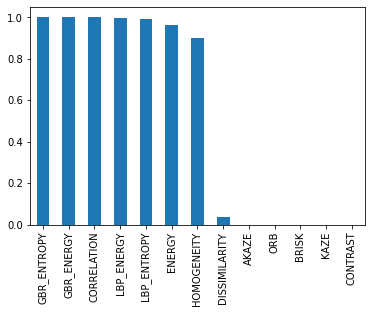

In [ ]:
import numpy as np
from sklearn.feature_selection import chi2
np.set_printoptions(precision=2)
X = tt
y = df_test['DETECT']
chi_scores = chi2(X,y)
print(type(chi_scores))
print(chi_scores) #here first array represents chi square values and second array represnts p-values
for i in chi_scores:
    print(i)
    for j in i:
        print("{:.5f}".format(j))



p_values = pd.Series(chi_scores[1],index = X.columns)
p_values.sort_values(ascending = False , inplace = True)   
p_values.plot.bar()

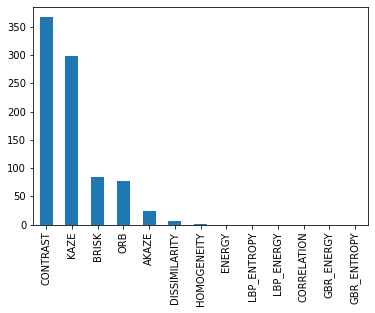

In [ ]:
p_values = pd.Series(chi_scores[0],index = X.columns)   ##Chi-squared value  CONTRAST has the highest value
p_values.sort_values(ascending = False , inplace = True)   
p_values.plot.bar()

/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:337: UserWarning:

The `size` parameter has been renamed to `height`; please update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (

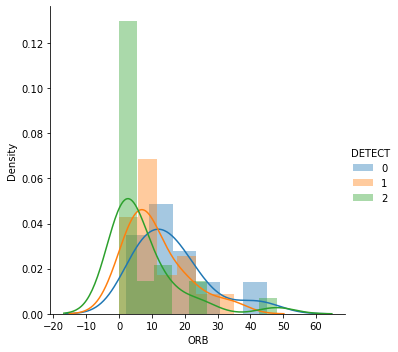

In [ ]:
import seaborn as sns, numpy as np
sns.FacetGrid(df_test,hue='DETECT',size=5).map(sns.distplot,'ORB').add_legend()

/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:337: UserWarning:

The `size` parameter has been renamed to `height`; please update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (

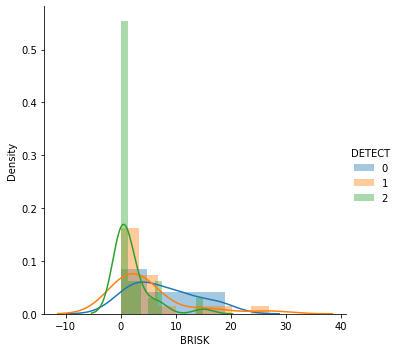

In [ ]:
import seaborn as sns, numpy as np
sns.FacetGrid(df_test,hue='DETECT',size=5).map(sns.distplot,'BRISK').add_legend()

/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:337: UserWarning:

The `size` parameter has been renamed to `height`; please update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (

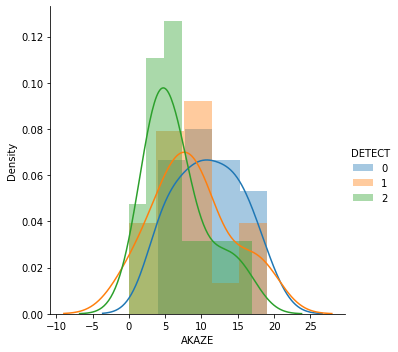

In [ ]:
import seaborn as sns, numpy as np
sns.FacetGrid(df_test,hue='DETECT',size=5).map(sns.distplot,'AKAZE').add_legend()

In [ ]:
search ="A"
bool_series = df_test["IMG_NAME"].str.endswith(search, na = False)
print(bool_series)
df_test[bool_series]

0     False
1     False
2     False
3     False
4     False
      ...  
61    False
62    False
63    False
64    False
65    False
Name: IMG_NAME, Length: 66, dtype: bool


,IMG_NAME,LBP_ENERGY,LBP_ENTROPY,CONTRAST,DISSIMILARITY,HOMOGENEITY,ENERGY,CORRELATION,GBR_ENERGY,GBR_ENTROPY,ORB,BRISK,AKAZE,KAZE,DETECT


In [ ]:
#Fill NAN values

df_test.head()
print(df_test.isnull().sum())
df_test['LBP_ENTROPY'].fillna(2.108496, inplace=True)

df_test.head()

IMG_NAME         0
LBP_ENERGY       0
LBP_ENTROPY      0
CONTRAST         0
DISSIMILARITY    0
HOMOGENEITY      0
ENERGY           0
CORRELATION      0
GBR_ENERGY       0
GBR_ENTROPY      0
ORB              0
BRISK            0
AKAZE            0
KAZE             0
DETECT           0
dtype: int64


,IMG_NAME,LBP_ENERGY,LBP_ENTROPY,CONTRAST,DISSIMILARITY,HOMOGENEITY,ENERGY,CORRELATION,GBR_ENERGY,GBR_ENTROPY,ORB,BRISK,AKAZE,KAZE,DETECT
0,0106,0.35491,1.86688,82.79262,5.45893,0.22483,0.02381,0.99224,0.20685,2.65001,2,0,5,48,0
1,0109,0.30108,2.07920,87.24277,5.32233,0.27576,0.08176,0.99154,0.21706,2.61030,17,6,15,65,0
2,0116,0.33092,2.01690,172.04063,7.54649,0.20163,0.01803,0.98401,0.22324,2.58433,5,6,9,126,0
3,0111,0.29793,2.14329,128.75700,6.26635,0.24840,0.04937,0.98785,0.21664,2.61321,24,18,14,117,0
4,0117,0.33850,1.96253,110.30962,6.36349,0.21895,0.04095,0.98964,0.22267,2.58127,16,4,12,98,0


In [ ]:
subset_test = df.filter(['IMG_NAME','ORB','BRISK','KAZE','AKAZE','CONTRAST', 'ENERGY', 'LBP_ENTROPY','DETECT'], axis=1)
print(len(subset_test))
#subset1 = subset1[~subset1['IMG_NAME'].str.contains('(?:_B)$')]
subset_test = subset_test[:11520]
print(len(subset_test))

66
66


In [ ]:
ln = 6
subset_test = subset_test.sort_values(by = ['ORB'])
subset_test['ORB_L1'] = 0
subset1_list = np.vsplit(subset_test, ln)

df_test['ORB_L1'] = 0
for row in range(len(df_test)):
    i = 1
    for df1 in subset1_list:
        #print(len(df1))
        df1['ORB_L1'] = i
        min1 = df1['ORB'].min()
        max1 = df1['ORB'].max()
        #print("ORB", df1['ORB'].min(), df1['ORB'].max())
        ##print(df1.head())
        if (df_test.loc[row, 'ORB'] >= min1) & (df_test.loc[row, 'ORB'] < max1) :
            df_test.loc[row, 'ORB_L1'] = i
        if (i==len(subset1_list)) &  (df_test.loc[row, 'ORB'] >= min1):
            df_test.loc[row, 'ORB_L1'] = i
        i += 1
                     

subset_test = subset_test.sort_values(by = ['AKAZE'])
subset_test['AKAZE_L1'] = 0
subset1_list = np.vsplit(subset_test, ln)

df_test['AKAZE_L1'] = 0
for row in range(len(df_test)):
    i = 1
    for df1 in subset1_list:
        df1['AKAZE_L1'] = i
        min1 = df1['AKAZE'].min()
        max1 = df1['AKAZE'].max()
        #print("AKAZE", df1['AKAZE'].min(), df1['AKAZE'].max() )
        #print(df1.head())
        if (df_test.loc[row, 'AKAZE'] >= min1) & (df_test.loc[row, 'AKAZE'] < max1) :
            df_test.loc[row, 'AKAZE_L1'] = i
        if (i==len(subset1_list)) &  (df_test.loc[row, 'AKAZE'] >= min1):
            df_test.loc[row, 'AKAZE_L1'] = i
        i += 1


subset_test = subset_test.sort_values(by = ['BRISK'])
subset_test['BRISK_L1'] = 0
subset1_list = np.vsplit(subset_test, ln)

df_test['BRISK_L1'] = 0
for row in range(len(df_test)):
    i = 1
    for df1 in subset1_list:
        df1['BRISK_L1'] = i
        min1 = df1['BRISK'].min()
        max1 = df1['BRISK'].max()
        #print("BRISK", df1['BRISK'].min(), df1['BRISK'].max() )
        #print(df1.head())
        if (df_test.loc[row, 'BRISK'] >= min1) & (df_test.loc[row, 'BRISK'] < max1) :
            df_test.loc[row, 'BRISK_L1'] = i
        i += 1

                    
subset_test = subset_test.sort_values(by = ['KAZE'])
subset_test['KAZE_L1'] = 0
subset1_list = np.vsplit(subset_test, ln)

df_test['KAZE_L1'] = 0
for row in range(len(df_test)):
    i = 1
    for df1 in subset1_list:
        df1['KAZE_L1'] = i
        min1 = df1['KAZE'].min()
        max1 = df1['KAZE'].max()
        #print("KAZE", df1['KAZE'].min(), df1['KAZE'].max() )
        #print(df1.head())
        if (df_test.loc[row, 'KAZE'] >= min1) & (df_test.loc[row, 'KAZE'] < max1) :
            df_test.loc[row, 'KAZE_L1'] = i
        if (i==len(subset1_list)) &  (df_test.loc[row, 'KAZE'] >= min1):
            df_test.loc[row, 'KAZE_L1'] = i
        i += 1

        
subset_test = subset_test.sort_values(by = ['CONTRAST'])
subset_test['CONTRAST_L1'] = 0
subset1_list = np.vsplit(subset_test, ln)

df_test['CONTRAST_L1'] = 0
for row in range(len(df_test)):
    i = 1
    for df1 in subset1_list:
        df1['CONTRAST_L1'] = i
        min1 = df1['CONTRAST'].min()
        max1 = df1['CONTRAST'].max()
        #print("CONTRAST", df1['CONTRAST'].min(), df1['CONTRAST'].max() )
        #print(df1.head())
        if (df_test.loc[row, 'CONTRAST'] >= min1) & (df_test.loc[row, 'CONTRAST'] < max1) :
            df_test.loc[row, 'CONTRAST_L1'] = i
        i += 1

        
subset_test = subset_test.sort_values(by = ['ENERGY'])
subset_test['ENERGY_L1'] = 0
subset1_list = np.vsplit(subset_test, ln)

df_test['ENERGY_L1'] = 0
for row in range(len(df_test)):
    i = 1
    for df1 in subset1_list:
        df1['ENERGY_L1'] = i
        min1 = df1['ENERGY'].min()
        max1 = df1['ENERGY'].max()
        #print("CONTRAST", df1['CONTRAST'].min(), df1['CONTRAST'].max() )
        #print(df1.head())
        if (df_test.loc[row, 'ENERGY'] >= min1) & (df_test.loc[row, 'ENERGY'] < max1) :
            df_test.loc[row, 'ENERGY_L1'] = i
        i += 1



### similarity test on test set 2

In [ ]:
sub = df_test.filter(['ORB', 'BRISK', 'AKAZE', 'DETECT'], axis=1)

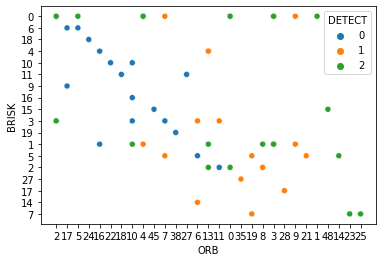

In [ ]:
sns.scatterplot(data=sub, x="ORB", y="BRISK", hue="DETECT")

In [ ]:
import plotly.express as px
from sklearn.decomposition import PCA

#df = df_test
features = ["ORB", "BRISK", "AKAZE"]

pca = PCA()
components = pca.fit_transform(df_test[features])
labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}

print(labels)

fig = px.scatter_matrix(
    components,
    labels=labels,
    dimensions=range(3),
    color=df_test["DETECT"], color_continuous_scale=px.colors.sequential.Inferno
)
fig.update_traces(diagonal_visible=False)
fig.update_layout(
    margin=dict(l=5, r=5, t=5, b=5),
    paper_bgcolor="white",
)
fig.show()

#{'0': 'PC 1 (73.1%)', '1': 'PC 2 (21.2%)', '2': 'PC 3 (5.7%)'}

{'0': 'PC 1 (89.5%)', '1': 'PC 2 (6.7%)', '2': 'PC 3 (3.8%)'}


In [ ]:
fig = px.bar(df_test, x="ORB", y="BRISK", color="DETECT", barmode="group")
fig.show()

In [ ]:
import plotly.express as px
from sklearn.decomposition import PCA

#df = px.data.iris()
X = df_test[['ORB', 'BRISK', 'AKAZE']]

pca = PCA(n_components=3)
components = pca.fit_transform(X)

total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    components, x=0, y=1, z=2, color=df_test['DETECT'],
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.update_layout(
    margin=dict(l=0, r=0, t=0, b=0),
    paper_bgcolor="white",
)
fig.show()
#fig.write_image("pc.png")

In [ ]:
import plotly.express as px
fig = px.scatter(df_test, x="ORB", y="BRISK", color="DETECT")
fig.show()

/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:337: UserWarning:

The `size` parameter has been renamed to `height`; please update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (

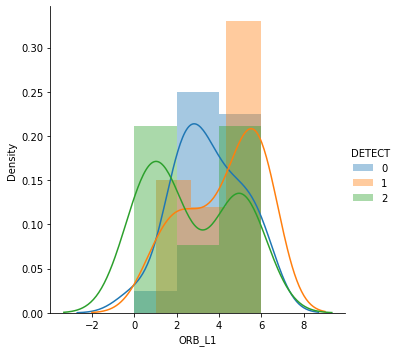

In [ ]:
import seaborn as sns, numpy as np
sns.FacetGrid(df_test,hue='DETECT',size=5).map(sns.distplot,'ORB_L1').add_legend()

/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:337: UserWarning:

The `size` parameter has been renamed to `height`; please update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (

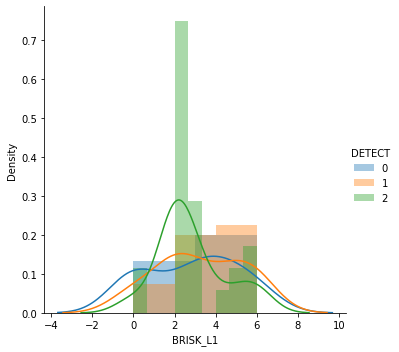

In [ ]:
import seaborn as sns, numpy as np
sns.FacetGrid(df_test,hue='DETECT',size=5).map(sns.distplot,'BRISK_L1').add_legend()

/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:337: UserWarning:

The `size` parameter has been renamed to `height`; please update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (

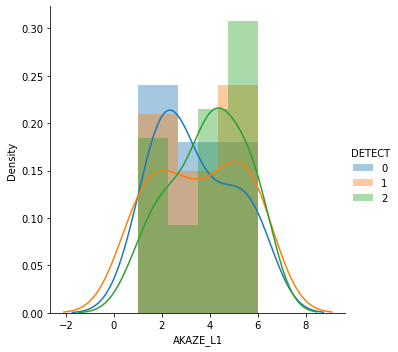

In [ ]:
import seaborn as sns, numpy as np
sns.FacetGrid(df_test,hue='DETECT',size=5).map(sns.distplot,'AKAZE_L1').add_legend()

In [ ]:
frame = [subset_test, df_test]
final = pd.concat(frame)
final = final.reset_index(drop=True)
final.to_csv (r'FINAL_DATASET_2.csv', index = False, header=True)

In [ ]:
#sub_test = sub_test.drop(['LBP_ENERGY', 'LBP_ENTROPY', 'CONTRAST', 'DISSIMILARITY', 'HOMOGENEITY'],axis=1)
#sub_test = sub_test.drop(['CONTRAST', 'DISSIMILARITY'],axis=1)
sub_test = df_test.drop(['DISSIMILARITY','HOMOGENEITY','CONTRAST','LBP_ENTROPY','LBP_ENERGY','ENERGY', 'CORRELATION', 'GBR_ENERGY', 'GBR_ENTROPY'],axis=1)
print(sub_test.describe())
print(subset_test.describe())

          ORB_L1   AKAZE_L1   BRISK_L1    KAZE_L1  CONTRAST_L1  ENERGY_L1
count  66.000000  66.000000  66.000000  66.000000    66.000000  66.000000
mean    3.393939   3.636364   2.954545   3.318182     3.121212   3.136364
std     1.975845   1.688298   1.940910   1.906742     1.965198   1.968102
min     0.000000   1.000000   0.000000   0.000000     0.000000   0.000000
25%     2.000000   2.000000   2.000000   2.000000     1.250000   1.250000
50%     3.500000   4.000000   3.000000   3.000000     3.000000   3.000000
75%     5.000000   5.000000   4.750000   5.000000     5.000000   5.000000
max     6.000000   6.000000   6.000000   6.000000     6.000000   6.000000
       ORB_L1  AKAZE_L1  BRISK_L1  KAZE_L1  CONTRAST_L1  ENERGY_L1
count    66.0      66.0      66.0     66.0         66.0       66.0
mean      0.0       0.0       0.0      0.0          0.0        0.0
std       0.0       0.0       0.0      0.0          0.0        0.0
min       0.0       0.0       0.0      0.0          0.0        0.0

### gtrs three way testting on test 1 

In [ ]:
sub_test["PRED"] = -1
sub_test["d_id"] = -1
covered = 0
#print(sub_test.head())
for row in range(len(sub_test)):
    for d_id, d_info in probdict.items():
        trai_df = d_info['df']
        trai_df = trai_df.reset_index(drop=True)
        if sub_test.loc[row, 'ORB_L1'] == trai_df.loc[0, 'ORB_L1'] : 
            if sub_test.loc[row, "BRISK_L1"] == trai_df.loc[0, "BRISK_L1"] :  
                if sub_test.loc[row, "AKAZE_L1"] == trai_df.loc[0, "AKAZE_L1"] :
                    sub_test.loc[row, "PRED"] = d_info["pred"]
                    sub_test.loc[row, "d_id"] = d_id
                    covered += 1
                    break

print("covered",covered)
w_cnt = 0
r_cnt = 0
n_cnt = 0
y_cnt = 0
b_cnt = 0
w_r_cnt = 0
w_n_cnt = 0 
w_b_cnt = 0
no_wrong =[]
yes_wrong=[]
bon_re=[]
total = len(sub_test)
#print(sub_test.head(50))
for row in range(len(sub_test)):
    if sub_test.loc[row, 'PRED'] != sub_test.loc[row, 'DETECT']:
        w_cnt += 1
        if sub_test.loc[row, 'PRED'] == 1:
            w_n_cnt += 1
            #print ("w_n_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
            no_wrong.append(sub_test.loc[row, 'IMG_NAME'])
        elif sub_test.loc[row, 'PRED'] == 0:
            w_r_cnt += 1
            #print ("w_r_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'], "actual", sub_test.loc[row, 'DETECT'])
            yes_wrong.append(sub_test.loc[row, 'IMG_NAME'])
        if sub_test.loc[row, 'PRED'] == 2:
            w_b_cnt += 1    
            bon_re.append(sub_test.loc[row, 'IMG_NAME'])
            #print ("w_b_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
    else:
        r_cnt += 1
        if sub_test.loc[row, 'PRED'] == 1:
            y_cnt += 1
        elif sub_test.loc[row, 'PRED'] == 0:
            n_cnt += 1
    if sub_test.loc[row, 'PRED'] == 2:
        b_cnt += 1
    
print("r_cnt", r_cnt)
print("w_cnt", w_cnt)
print("total", total)
print("b_cnt", b_cnt)
print("y_cnt", y_cnt)
print("n_cnt", n_cnt)
print("w_r_cnt", w_r_cnt)
print("w_n_cnt", w_n_cnt)
print("w_b_cnt", w_b_cnt)
print("Accuracy", 100 *  (r_cnt)/covered)
print("Decision made", 100 *  (r_cnt+w_r_cnt+w_n_cnt)/covered) #according to coverage formula  
print("Decision accuracy", 100 *  r_cnt/(covered-b_cnt))
print("+- accuracy", 100 *  r_cnt/(r_cnt+w_r_cnt+w_n_cnt)) #according to accuracy formula  

covered 29
r_cnt 0
w_cnt 66
total 66
b_cnt 12
y_cnt 0
n_cnt 0
w_r_cnt 17
w_n_cnt 0
w_b_cnt 12
Accuracy 0.0
Decision made 58.62068965517241
Decision accuracy 0.0
+- accuracy 0.0


In [ ]:
sub_test["PRED"] = -1
sub_test["d_id"] = -1
covered = 0
#print(sub_test.head())
for row in range(len(sub_test)):
    for d_id, d_info in probdict.items():
        trai_df = d_info['df']
        trai_df = trai_df.reset_index(drop=True)
        if sub_test.loc[row, 'ORB_L1'] == trai_df.loc[0, 'ORB_L1'] : 
            if sub_test.loc[row, "BRISK_L1"] == trai_df.loc[0, "BRISK_L1"] :  
                if sub_test.loc[row, "AKAZE_L1"] == trai_df.loc[0, "AKAZE_L1"] :
                    sub_test.loc[row, "PRED"] = d_info["pred"]
                    sub_test.loc[row, "d_id"] = d_id
                    covered += 1
                    break

print("covered",covered)
w_cnt = 0
r_cnt = 0
n_cnt = 0
y_cnt = 0
b_cnt = 0
w_r_cnt = 0
w_n_cnt = 0 
w_b_cnt = 0
no_wrong =[]
yes_wrong=[]
bon_re=[]
total = len(sub_test)
#print(sub_test.head(50))
for row in range(len(sub_test)):
    if sub_test.loc[row, 'PRED'] != sub_test.loc[row, 'DETECT']:
        w_cnt += 1
        if sub_test.loc[row, 'PRED'] == 1:
            w_n_cnt += 1
            #print ("w_n_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
            no_wrong.append(sub_test.loc[row, 'IMG_NAME'])
        elif sub_test.loc[row, 'PRED'] == 0:
            w_r_cnt += 1
            #print ("w_r_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'], "actual", sub_test.loc[row, 'DETECT'])
            yes_wrong.append(sub_test.loc[row, 'IMG_NAME'])
        if sub_test.loc[row, 'PRED'] == 2:
            w_b_cnt += 1    
            bon_re.append(sub_test.loc[row, 'IMG_NAME'])
            #print ("w_b_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
    else:
        r_cnt += 1
        if sub_test.loc[row, 'PRED'] == 1:
            y_cnt += 1
        elif sub_test.loc[row, 'PRED'] == 0:
            n_cnt += 1
    if sub_test.loc[row, 'PRED'] == 2:
        b_cnt += 1
    
print("r_cnt", r_cnt)
print("w_cnt", w_cnt)
print("total", total)
print("b_cnt", b_cnt)
print("y_cnt", y_cnt)
print("n_cnt", n_cnt)
print("w_r_cnt", w_r_cnt)
print("w_n_cnt", w_n_cnt)
print("w_b_cnt", w_b_cnt)
print("Accuracy", 100 *  (r_cnt)/covered)
print("Decision made", 100 *  (r_cnt+w_r_cnt+w_n_cnt)/covered) #according to coverage formula  
print("Decision accuracy", 100 *  r_cnt/(covered-b_cnt))
print("+- accuracy", 100 *  r_cnt/(r_cnt+w_r_cnt+w_n_cnt)) #according to accuracy formula  

covered 29
r_cnt 0
w_cnt 66
total 66
b_cnt 12
y_cnt 0
n_cnt 0
w_r_cnt 17
w_n_cnt 0
w_b_cnt 12
Accuracy 0.0
Decision made 58.62068965517241
Decision accuracy 0.0
+- accuracy 0.0


In [ ]:
sub_test["PRED"] = -1
sub_test["d_id"] = -1
covered = 0
#print(sub_test.head())
for row in range(len(sub_test)):
    for d_id, d_info in probdict.items():
        trai_df = d_info['df']
        trai_df = trai_df.reset_index(drop=True)
        if sub_test.loc[row, 'ORB_L1'] == trai_df.loc[0, 'ORB_L1'] : 
            if sub_test.loc[row, "BRISK_L1"] == trai_df.loc[0, "BRISK_L1"] :  
                if sub_test.loc[row, "AKAZE_L1"] == trai_df.loc[0, "AKAZE_L1"] :
                    sub_test.loc[row, "PRED"] = d_info["pred"]
                    sub_test.loc[row, "d_id"] = d_id
                    covered += 1
                    break

print("covered",covered)
w_cnt = 0
r_cnt = 0
n_cnt = 0
y_cnt = 0
b_cnt = 0
w_r_cnt = 0
w_n_cnt = 0 
w_b_cnt = 0
no_wrong =[]
yes_wrong=[]
bon_re=[]
total = len(sub_test)
#print(sub_test.head(50))
for row in range(len(sub_test)):
    if sub_test.loc[row, 'PRED'] != sub_test.loc[row, 'DETECT']:
        w_cnt += 1
        if sub_test.loc[row, 'PRED'] == 1:
            w_n_cnt += 1
            #print ("w_n_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
            no_wrong.append(sub_test.loc[row, 'IMG_NAME'])
        elif sub_test.loc[row, 'PRED'] == 0:
            w_r_cnt += 1
            #print ("w_r_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
            yes_wrong.append(sub_test.loc[row, 'IMG_NAME'])
        if sub_test.loc[row, 'PRED'] == 2:
            w_b_cnt += 1    
            bon_re.append(sub_test.loc[row, 'IMG_NAME'])
            #print ("w_b_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'], "Actual", sub_test.loc[row, 'DETECT'])
    else:
        r_cnt += 1
        if sub_test.loc[row, 'PRED'] == 1:
            y_cnt += 1
        elif sub_test.loc[row, 'PRED'] == 0:
            n_cnt += 1
    if sub_test.loc[row, 'PRED'] == 2:
        b_cnt += 1
    
print("r_cnt", r_cnt)
print("w_cnt", w_cnt)
print("total", total)
print("b_cnt", b_cnt)
print("y_cnt", y_cnt)
print("n_cnt", n_cnt)
print("w_r_cnt", w_r_cnt)
print("w_n_cnt", w_n_cnt)
print("w_b_cnt", w_b_cnt)
print("Accuracy", 100 *  (r_cnt)/covered)
print("Decision made", 100 *  (r_cnt+w_r_cnt+w_n_cnt)/covered) #according to coverage formula  
print("Decision accuracy", 100 *  r_cnt/(covered-b_cnt))
print("+- accuracy", 100 *  r_cnt/(r_cnt+w_r_cnt+w_n_cnt)) #according to accuracy formula  

covered 29
r_cnt 0
w_cnt 66
total 66
b_cnt 12
y_cnt 0
n_cnt 0
w_r_cnt 17
w_n_cnt 0
w_b_cnt 12
Accuracy 0.0
Decision made 58.62068965517241
Decision accuracy 0.0
+- accuracy 0.0


In [ ]:
sub_test["PRED"] = -1
sub_test["d_id"] = -1
covered = 0
#print(sub_test.head())
for row in range(len(sub_test)):
    for d_id, d_info in probdict.items():
        trai_df = d_info['df']
        trai_df = trai_df.reset_index(drop=True)
        if sub_test.loc[row, 'ORB_L1'] == trai_df.loc[0, 'ORB_L1'] : 
            if sub_test.loc[row, "BRISK_L1"] == trai_df.loc[0, "BRISK_L1"] :  
                if sub_test.loc[row, "AKAZE_L1"] == trai_df.loc[0, "AKAZE_L1"] :
                    sub_test.loc[row, "PRED"] = d_info["pred"]
                    sub_test.loc[row, "d_id"] = d_id
                    covered += 1
                    break

print("covered",covered)
w_cnt = 0
r_cnt = 0
n_cnt = 0
y_cnt = 0
b_cnt = 0
w_r_cnt = 0
w_n_cnt = 0 
w_b_cnt = 0
no_wrong =[]
yes_wrong=[]
bon_re=[]
total = len(sub_test)
#print(sub_test.head(50))
for row in range(len(sub_test)):
    if sub_test.loc[row, 'PRED'] != sub_test.loc[row, 'DETECT']:
        w_cnt += 1
        if sub_test.loc[row, 'PRED'] == 1:
            w_n_cnt += 1
            print ("w_n_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
            no_wrong.append(sub_test.loc[row, 'IMG_NAME'])
        elif sub_test.loc[row, 'PRED'] == 0:
            w_r_cnt += 1
            print ("w_r_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
            yes_wrong.append(sub_test.loc[row, 'IMG_NAME'])
        if sub_test.loc[row, 'PRED'] == 2:
            w_b_cnt += 1    
            bon_re.append(sub_test.loc[row, 'IMG_NAME'])
            #print ("w_b_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
    else:
        r_cnt += 1
        if sub_test.loc[row, 'PRED'] == 1:
            y_cnt += 1
        elif sub_test.loc[row, 'PRED'] == 0:
            n_cnt += 1
    if sub_test.loc[row, 'PRED'] == 2:
        b_cnt += 1
    
print("r_cnt", r_cnt)
print("w_cnt", w_cnt)
print("total", total)
print("b_cnt", b_cnt)
print("y_cnt", y_cnt)
print("n_cnt", n_cnt)
print("w_r_cnt", w_r_cnt)
print("w_n_cnt", w_n_cnt)
print("w_b_cnt", w_b_cnt)
print("Accuracy", 100 *  (r_cnt)/covered)
print("Decision made", 100 *  (r_cnt+w_r_cnt+w_n_cnt)/covered) #according to coverage formula  
print("Decision accuracy", 100 *  r_cnt/(covered-b_cnt))
print("+- accuracy", 100 *  r_cnt/(r_cnt+w_r_cnt+w_n_cnt)) #according to accuracy formula  

covered 29
w_r_cnt 0106 d_id 64
w_r_cnt 0117 d_id 20
w_r_cnt 0114 d_id 7
w_r_cnt 0110 d_id 18
w_r_cnt 0102 d_id 60
w_r_cnt 0122 d_id 16
w_r_cnt 0111 d_id 43
w_r_cnt 0105 d_id 48
w_r_cnt auntminnie-a-2020_01_28_23_51_6665_2020_01_28_Vietnam_coronavirus d_id 60
w_r_cnt 0106 d_id 31
w_r_cnt COVID-00003b d_id 66
w_r_cnt auntminnie-b-2020_01_28_23_51_6665_2020_01_28_Vietnam_coronavirus d_id 17
w_r_cnt radiopaedia-2019-novel-coronavirus-infected-pneumonia d_id 48
w_r_cnt 0115 d_id 66
w_r_cnt COVID-00012 d_id 60
w_r_cnt 096 d_id 49
w_r_cnt 0113 d_id 60
r_cnt 0
w_cnt 66
total 66
b_cnt 12
y_cnt 0
n_cnt 0
w_r_cnt 17
w_n_cnt 0
w_b_cnt 12
Accuracy 0.0
Decision made 58.62068965517241
Decision accuracy 0.0
+- accuracy 0.0


In [ ]:
sub_test["PRED"] = -1
sub_test["d_id"] = -1
covered = 0
#print(sub_test.head())
for row in range(len(sub_test)):
    for d_id, d_info in probdict.items():
        trai_df = d_info['df']
        trai_df = trai_df.reset_index(drop=True)
        if sub_test.loc[row, 'ORB_L1'] == trai_df.loc[0, 'ORB_L1'] : 
            if sub_test.loc[row, "BRISK_L1"] == trai_df.loc[0, "BRISK_L1"] :  
                if sub_test.loc[row, "AKAZE_L1"] == trai_df.loc[0, "AKAZE_L1"] :
                    sub_test.loc[row, "PRED"] = d_info["pred"]
                    sub_test.loc[row, "d_id"] = d_id
                    covered += 1
                    break

print("covered",covered)
w_cnt = 0
r_cnt = 0
n_cnt = 0
y_cnt = 0
b_cnt = 0
w_r_cnt = 0
w_n_cnt = 0 
w_b_cnt = 0
no_wrong =[]
yes_wrong=[]
bon_re=[]
total = len(sub_test)
#print(sub_test.head(50))
for row in range(len(sub_test)):
    if sub_test.loc[row, 'PRED'] != sub_test.loc[row, 'DETECT']:
        w_cnt += 1
        if sub_test.loc[row, 'PRED'] == 1:
            w_n_cnt += 1
            print ("w_n_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
            no_wrong.append(sub_test.loc[row, 'IMG_NAME'])
        elif sub_test.loc[row, 'PRED'] == 0:
            w_r_cnt += 1
            print ("w_r_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
            yes_wrong.append(sub_test.loc[row, 'IMG_NAME'])
        if sub_test.loc[row, 'PRED'] == 2:
            w_b_cnt += 1    
            bon_re.append(sub_test.loc[row, 'IMG_NAME'])
            #print ("w_b_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
    else:
        r_cnt += 1
        if sub_test.loc[row, 'PRED'] == 1:
            y_cnt += 1
        elif sub_test.loc[row, 'PRED'] == 0:
            n_cnt += 1
    if sub_test.loc[row, 'PRED'] == 2:
        b_cnt += 1
    
print("r_cnt", r_cnt)
print("w_cnt", w_cnt)
print("total", total)
print("b_cnt", b_cnt)
print("y_cnt", y_cnt)
print("n_cnt", n_cnt)
print("w_r_cnt", w_r_cnt)
print("w_n_cnt", w_n_cnt)
print("w_b_cnt", w_b_cnt)
print("Accuracy", 100 *  (r_cnt)/covered)
print("Decision made", 100 *  (r_cnt+w_r_cnt+w_n_cnt)/covered) #according to coverage formula  
print("Decision accuracy", 100 *  r_cnt/(covered-b_cnt))
print("+- accuracy", 100 *  r_cnt/(r_cnt+w_r_cnt+w_n_cnt)) #according to accuracy formula  

covered 29
w_r_cnt 0106 d_id 64
w_r_cnt 0117 d_id 20
w_r_cnt 0114 d_id 7
w_r_cnt 0110 d_id 18
w_r_cnt 0102 d_id 60
w_r_cnt 0122 d_id 16
w_r_cnt 0111 d_id 43
w_r_cnt 0105 d_id 48
w_r_cnt auntminnie-a-2020_01_28_23_51_6665_2020_01_28_Vietnam_coronavirus d_id 60
w_r_cnt 0106 d_id 31
w_r_cnt COVID-00003b d_id 66
w_r_cnt auntminnie-b-2020_01_28_23_51_6665_2020_01_28_Vietnam_coronavirus d_id 17
w_r_cnt radiopaedia-2019-novel-coronavirus-infected-pneumonia d_id 48
w_r_cnt 0115 d_id 66
w_r_cnt COVID-00012 d_id 60
w_r_cnt 096 d_id 49
w_r_cnt 0113 d_id 60
r_cnt 0
w_cnt 66
total 66
b_cnt 12
y_cnt 0
n_cnt 0
w_r_cnt 17
w_n_cnt 0
w_b_cnt 12
Accuracy 0.0
Decision made 58.62068965517241
Decision accuracy 0.0
+- accuracy 0.0


In [ ]:
sub_test["PRED"] = -1
sub_test["d_id"] = -1
covered = 0
#print(sub_test.head())
for row in range(len(sub_test)):
    for d_id, d_info in probdict.items():
        trai_df = d_info['df']
        trai_df = trai_df.reset_index(drop=True)
        if sub_test.loc[row, 'ORB_L1'] == trai_df.loc[0, 'ORB_L1'] : 
            if sub_test.loc[row, "BRISK_L1"] == trai_df.loc[0, "BRISK_L1"] :  
                if sub_test.loc[row, "AKAZE_L1"] == trai_df.loc[0, "AKAZE_L1"] :
                    sub_test.loc[row, "PRED"] = d_info["pred"]
                    sub_test.loc[row, "d_id"] = d_id
                    covered += 1
                    break

print("covered",covered)
w_cnt = 0
r_cnt = 0
n_cnt = 0
y_cnt = 0
b_cnt = 0
w_r_cnt = 0
w_n_cnt = 0 
w_b_cnt = 0
no_wrong =[]
yes_wrong=[]
bon_re=[]
total = len(sub_test)
#print(sub_test.head(50))
for row in range(len(sub_test)):
    if sub_test.loc[row, 'PRED'] != sub_test.loc[row, 'DETECT']:
        w_cnt += 1
        if sub_test.loc[row, 'PRED'] == 1:
            w_n_cnt += 1
            print ("w_n_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
            no_wrong.append(sub_test.loc[row, 'IMG_NAME'])
        elif sub_test.loc[row, 'PRED'] == 0:
            w_r_cnt += 1
            print ("w_r_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
            yes_wrong.append(sub_test.loc[row, 'IMG_NAME'])
        if sub_test.loc[row, 'PRED'] == 2:
            w_b_cnt += 1    
            bon_re.append(sub_test.loc[row, 'IMG_NAME'])
            #print ("w_b_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
    else:
        r_cnt += 1
        if sub_test.loc[row, 'PRED'] == 1:
            y_cnt += 1
        elif sub_test.loc[row, 'PRED'] == 0:
            n_cnt += 1
    if sub_test.loc[row, 'PRED'] == 2:
        b_cnt += 1
    
print("r_cnt", r_cnt)
print("w_cnt", w_cnt)
print("total", total)
print("b_cnt", b_cnt)
print("y_cnt", y_cnt)
print("n_cnt", n_cnt)
print("w_r_cnt", w_r_cnt)
print("w_n_cnt", w_n_cnt)
print("w_b_cnt", w_b_cnt)
print("Accuracy", 100 *  (r_cnt)/covered)
print("Decision made", 100 *  (r_cnt+w_r_cnt+w_n_cnt)/covered) #according to coverage formula  
print("Decision accuracy", 100 *  r_cnt/(covered-b_cnt))
print("+- accuracy", 100 *  r_cnt/(r_cnt+w_r_cnt+w_n_cnt)) #according to accuracy formula  

covered 29
w_r_cnt 0106 d_id 64
w_r_cnt 0117 d_id 20
w_r_cnt 0114 d_id 7
w_r_cnt 0110 d_id 18
w_r_cnt 0102 d_id 60
w_r_cnt 0122 d_id 16
w_r_cnt 0111 d_id 43
w_r_cnt 0105 d_id 48
w_r_cnt auntminnie-a-2020_01_28_23_51_6665_2020_01_28_Vietnam_coronavirus d_id 60
w_r_cnt 0106 d_id 31
w_r_cnt COVID-00003b d_id 66
w_r_cnt auntminnie-b-2020_01_28_23_51_6665_2020_01_28_Vietnam_coronavirus d_id 17
w_r_cnt radiopaedia-2019-novel-coronavirus-infected-pneumonia d_id 48
w_r_cnt 0115 d_id 66
w_r_cnt COVID-00012 d_id 60
w_r_cnt 096 d_id 49
w_r_cnt 0113 d_id 60
r_cnt 0
w_cnt 66
total 66
b_cnt 12
y_cnt 0
n_cnt 0
w_r_cnt 17
w_n_cnt 0
w_b_cnt 12
Accuracy 0.0
Decision made 58.62068965517241
Decision accuracy 0.0
+- accuracy 0.0


In [ ]:
sub_test["PRED"] = -1
sub_test["d_id"] = -1
covered = 0
#print(sub_test.head())
for row in range(len(sub_test)):
    for d_id, d_info in probdict.items():
        trai_df = d_info['df']
        trai_df = trai_df.reset_index(drop=True)
        if sub_test.loc[row, 'ORB_L1'] == trai_df.loc[0, 'ORB_L1'] : 
            if sub_test.loc[row, "BRISK_L1"] == trai_df.loc[0, "BRISK_L1"] :  
                if sub_test.loc[row, "AKAZE_L1"] == trai_df.loc[0, "AKAZE_L1"] :
                    sub_test.loc[row, "PRED"] = d_info["pred"]
                    sub_test.loc[row, "d_id"] = d_id
                    covered += 1
                    break

print("covered",covered)
w_cnt = 0
r_cnt = 0
n_cnt = 0
y_cnt = 0
b_cnt = 0
w_r_cnt = 0
w_n_cnt = 0 
w_b_cnt = 0
no_wrong =[]
yes_wrong=[]
bon_re=[]
total = len(sub_test)
#print(sub_test.head(50))
for row in range(len(sub_test)):
    if sub_test.loc[row, 'PRED'] != sub_test.loc[row, 'DETECT']:
        w_cnt += 1
        if sub_test.loc[row, 'PRED'] == 1:
            w_n_cnt += 1
            print ("w_n_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
            no_wrong.append(sub_test.loc[row, 'IMG_NAME'])
        elif sub_test.loc[row, 'PRED'] == 0:
            w_r_cnt += 1
            print ("w_r_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
            yes_wrong.append(sub_test.loc[row, 'IMG_NAME'])
        if sub_test.loc[row, 'PRED'] == 2:
            w_b_cnt += 1    
            bon_re.append(sub_test.loc[row, 'IMG_NAME'])
            #print ("w_b_cnt", sub_test.loc[row, 'IMG_NAME'], "d_id", sub_test.loc[row, 'd_id'])
    else:
        r_cnt += 1
        if sub_test.loc[row, 'PRED'] == 1:
            y_cnt += 1
        elif sub_test.loc[row, 'PRED'] == 0:
            n_cnt += 1
    if sub_test.loc[row, 'PRED'] == 2:
        b_cnt += 1
    
print("r_cnt", r_cnt)
print("w_cnt", w_cnt)
print("total", total)
print("b_cnt", b_cnt)
print("y_cnt", y_cnt)
print("n_cnt", n_cnt)
print("w_r_cnt", w_r_cnt)
print("w_n_cnt", w_n_cnt)
print("w_b_cnt", w_b_cnt)
print("Accuracy", 100 *  (r_cnt)/covered)
print("Decision made", 100 *  (r_cnt+w_r_cnt+w_n_cnt)/covered) #according to coverage formula  
print("Decision accuracy", 100 *  r_cnt/(covered-b_cnt))
print("+- accuracy", 100 *  r_cnt/(r_cnt+w_r_cnt+w_n_cnt)) #according to accuracy formula  

covered 29
w_r_cnt 0106 d_id 64
w_r_cnt 0117 d_id 20
w_r_cnt 0114 d_id 7
w_r_cnt 0110 d_id 18
w_r_cnt 0102 d_id 60
w_r_cnt 0122 d_id 16
w_r_cnt 0111 d_id 43
w_r_cnt 0105 d_id 48
w_r_cnt auntminnie-a-2020_01_28_23_51_6665_2020_01_28_Vietnam_coronavirus d_id 60
w_r_cnt 0106 d_id 31
w_r_cnt COVID-00003b d_id 66
w_r_cnt auntminnie-b-2020_01_28_23_51_6665_2020_01_28_Vietnam_coronavirus d_id 17
w_r_cnt radiopaedia-2019-novel-coronavirus-infected-pneumonia d_id 48
w_r_cnt 0115 d_id 66
w_r_cnt COVID-00012 d_id 60
w_r_cnt 096 d_id 49
w_r_cnt 0113 d_id 60
r_cnt 0
w_cnt 66
total 66
b_cnt 12
y_cnt 0
n_cnt 0
w_r_cnt 17
w_n_cnt 0
w_b_cnt 12
Accuracy 0.0
Decision made 58.62068965517241
Decision accuracy 0.0
+- accuracy 0.0
